In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
pd.options.display.max_columns = None
pd.options.display.max_rows = None
pd.options.display.float_format = '{:.6f}'.format

In [2]:
df = pd.read_csv("medical_noshow.csv")
df.head()

,PatientId,AppointmentID,Gender,ScheduledDay,AppointmentDay,Age,Neighbourhood,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,No-show
0,29872499824296.000000,5642903.000000,F,2016-04-29T18:38:08Z,2016-04-29T00:00:00Z,NaN,'JARDIM DA PENHA',0.000000,1,0,0.000000,0.000000,0.000000,No
1,558997776694438.000000,5642503.000000,M,2016-04-29T16:08:27Z,2016-04-29T00:00:00Z,56.000000,'JARDIM DA PENHA',0.000000,0,0,0.000000,0.000000,0.000000,No
2,4262962299951.000000,5642549.000000,F,2016-04-29T16:19:04Z,2016-04-29T00:00:00Z,62.000000,'MATA DA PRAIA',0.000000,0,0,0.000000,0.000000,0.000000,No
3,867951213174.000000,5642828.000000,F,2016-04-29T17:29:31Z,2016-04-29T00:00:00Z,8.000000,'PONTAL DE CAMBURI',0.000000,0,0,0.000000,0.000000,0.000000,No
4,8841186448183.000000,5642494.000000,F,2016-04-29T16:07:23Z,2016-04-29T00:00:00Z,56.000000,'JARDIM DA PENHA',0.000000,1,1,0.000000,0.000000,0.000000,No


In [3]:
df.shape

(110527, 14)

We see that there are 110527 number of rows and 14 features.

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 110527 entries, 0 to 110526
Data columns (total 14 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   PatientId       98443 non-null   float64
 1   AppointmentID   95676 non-null   float64
 2   Gender          103453 non-null  object 
 3   ScheduledDay    101926 non-null  object 
 4   AppointmentDay  106703 non-null  object 
 5   Age             101461 non-null  float64
 6   Neighbourhood   90984 non-null   object 
 7   Scholarship     105043 non-null  float64
 8   Hipertension    110527 non-null  int64  
 9   Diabetes        110527 non-null  int64  
 10  Alcoholism      102861 non-null  float64
 11  Handcap         102387 non-null  float64
 12  SMS_received    107824 non-null  float64
 13  No-show         110527 non-null  object 
dtypes: float64(7), int64(2), object(5)
memory usage: 11.8+ MB


We can see from the above table that missing values are present and Gender,ScheduledDay,AppointmentDay,Neighbourhood and No-show are object datatype whereas the rest are all float and integer datatype.

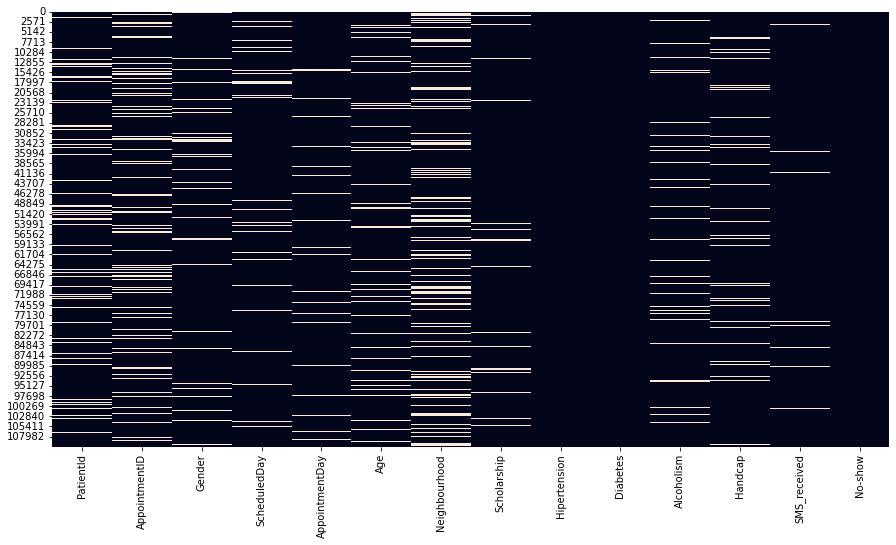

In [5]:
plt.rcParams['figure.figsize'] = (15,8)

sns.heatmap(df.isnull(), cbar=False)
plt.style.use('fivethirtyeight')
plt.show()

In [6]:
missing = pd.DataFrame(df.isnull().sum(), columns = ['Total_missing'])
missing['Percent Missing'] = round(df.isnull().sum()*100/len(df),2)
missing.sort_values(by='Percent Missing', ascending=False)

,Total_missing,Percent Missing
Neighbourhood,19543,17.680000
AppointmentID,14851,13.440000
PatientId,12084,10.930000
Age,9066,8.200000
ScheduledDay,8601,7.780000
Handcap,8140,7.360000
Alcoholism,7666,6.940000
Gender,7074,6.400000
Scholarship,5484,4.960000
AppointmentDay,3824,3.460000


From the above result we can verify that there are indeed missing values present in the dataset. For Neighbourhood around 17.68 % is missing, AppointmentID has 13.44% missing values, PatientID has around 10.93% missing values and others have less that 10% missing values.

In [7]:
df[df.duplicated() == True]

,PatientId,AppointmentID,Gender,ScheduledDay,AppointmentDay,Age,Neighbourhood,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,No-show
21023,15298285757127.000000,NaN,F,2016-04-27T09:58:26Z,2016-05-09T00:00:00Z,42.000000,GOIABEIRAS,1.000000,1,0,0.000000,0.000000,0.000000,No
63898,4497415116.000000,NaN,F,2016-05-13T08:57:16Z,2016-05-20T00:00:00Z,11.000000,'BELA VISTA',0.000000,0,0,0.000000,0.000000,0.000000,No
74979,2545574861214.000000,NaN,F,2016-04-26T07:36:39Z,2016-05-02T00:00:00Z,60.000000,'ILHA DAS CAIEIRAS',0.000000,1,1,0.000000,0.000000,0.000000,No


In [8]:
df = df.drop_duplicates()
df.duplicated().sum()

0

In [9]:
df.shape

(110524, 14)

In [10]:
df.head()

,PatientId,AppointmentID,Gender,ScheduledDay,AppointmentDay,Age,Neighbourhood,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,No-show
0,29872499824296.000000,5642903.000000,F,2016-04-29T18:38:08Z,2016-04-29T00:00:00Z,NaN,'JARDIM DA PENHA',0.000000,1,0,0.000000,0.000000,0.000000,No
1,558997776694438.000000,5642503.000000,M,2016-04-29T16:08:27Z,2016-04-29T00:00:00Z,56.000000,'JARDIM DA PENHA',0.000000,0,0,0.000000,0.000000,0.000000,No
2,4262962299951.000000,5642549.000000,F,2016-04-29T16:19:04Z,2016-04-29T00:00:00Z,62.000000,'MATA DA PRAIA',0.000000,0,0,0.000000,0.000000,0.000000,No
3,867951213174.000000,5642828.000000,F,2016-04-29T17:29:31Z,2016-04-29T00:00:00Z,8.000000,'PONTAL DE CAMBURI',0.000000,0,0,0.000000,0.000000,0.000000,No
4,8841186448183.000000,5642494.000000,F,2016-04-29T16:07:23Z,2016-04-29T00:00:00Z,56.000000,'JARDIM DA PENHA',0.000000,1,1,0.000000,0.000000,0.000000,No


In [11]:
df.describe(include=np.number)

,PatientId,AppointmentID,Age,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received
count,98440.000000,95676.000000,101458.000000,105040.000000,110524.000000,110524.000000,102858.000000,102384.000000,107821.000000
mean,147714363548228.875000,5675122.011393,37.070118,0.098105,0.197233,0.071858,0.030323,0.022162,0.321069
std,256333539953418.500000,71529.398432,23.118286,0.297459,0.397912,0.258253,0.171476,0.161208,0.466889
min,39217.844390,5030230.000000,-1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,4172438270616.250000,5640153.500000,18.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,31725301205606.500000,5680510.000000,37.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,94393811856983.000000,5725496.000000,55.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
max,999981631772427.000000,5790484.000000,115.000000,1.000000,1.000000,1.000000,1.000000,4.000000,1.000000


From the five point summary we see that average age is around 37 years. On an average 9.81% of patients has the facility of scholarship. Also 19.72 % of patients suffers from hypertension on an average, 7.2% of patients suffers from diabetes on an average, On an average 3% of patient consumes alcohol. only 2.2% of patients are handicap on an average and 32% of patients received sms before appointment atleast once on an average.

Also in the Age variable outliers is present.

In [12]:
df['Age'] = df['Age'].replace(-1, np.NaN)

We see that Age has negetive values which is not possible, so we replace as null value so that it can be later imputed using knn imputer.

In [13]:
df.describe(include='object')

,Gender,ScheduledDay,AppointmentDay,Neighbourhood,No-show
count,103450,101923,106700,90981,110524
unique,2,95974,27,81,2
top,F,2016-05-06T07:09:54Z,2016-06-06T00:00:00Z,'JARDIM CAMBURI',No
freq,67214,21,4549,6383,88205


From the above summary we can see that there are more female patients, Most of the patients called for appointment on 06-05-2016, Most of the patiesnt's appointment was on 06-06-2016, Most of the patients came from JARDIM CAMBURI neighborhood.

In [14]:
df.nunique()

PatientId         58017
AppointmentID     95676
Gender                2
ScheduledDay      95974
AppointmentDay       27
Age                 103
Neighbourhood        81
Scholarship           2
Hipertension          2
Diabetes              2
Alcoholism            2
Handcap               5
SMS_received          2
No-show               2
dtype: int64

In [15]:
(df['Neighbourhood'].value_counts(normalize = True) * 100)

'JARDIM CAMBURI'               7.015751
'MARIA ORTIZ'                  5.226366
RESISTNCIA                     4.027214
'JARDIM DA PENHA'              3.457865
ITARAR                         3.175388
CENTRO                         3.037997
'SANTA MARTHA'                 2.829162
TABUAZEIRO                     2.800585
'JESUS DE NAZARETH'            2.571966
'SANTO ANTNIO'                 2.530199
BONFIM                         2.486233
CARATORA                       2.344446
'SANTO ANDR'                   2.333454
JABOUR                         2.263110
'SO PEDRO'                     2.181774
'NOVA PALESTINA'               2.070762
'ILHA DO PRNCIPE'              2.057572
ANDORINHAS                     2.050978
'DA PENHA'                     2.008112
ROMO                           2.005913
GURIGICA                       1.833350
'SO JOS'                       1.824557
'BELA VISTA'                   1.735527
MARUPE                         1.734428
'FORTE SO JOO'                 1.715743


In [16]:
df.describe()

,PatientId,AppointmentID,Age,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received
count,98440.000000,95676.000000,101457.000000,105040.000000,110524.000000,110524.000000,102858.000000,102384.000000,107821.000000
mean,147714363548228.875000,5675122.011393,37.070493,0.098105,0.197233,0.071858,0.030323,0.022162,0.321069
std,256333539953418.500000,71529.398432,23.118091,0.297459,0.397912,0.258253,0.171476,0.161208,0.466889
min,39217.844390,5030230.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,4172438270616.250000,5640153.500000,18.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,31725301205606.500000,5680510.000000,37.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,94393811856983.000000,5725496.000000,55.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
max,999981631772427.000000,5790484.000000,115.000000,1.000000,1.000000,1.000000,1.000000,4.000000,1.000000


## Univariate Analysis

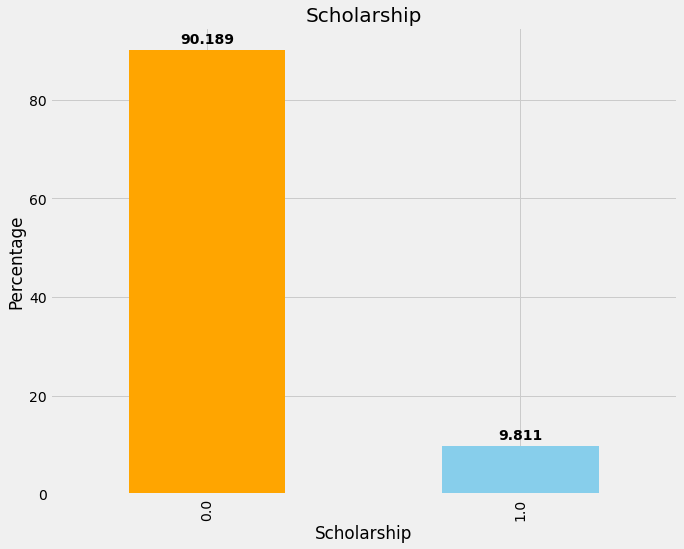

In [17]:
def plot_value_counts(df, col):
    plt.figure(figsize=(10, 8))
    plt.title(col, fontsize=20)
    plt.xlabel(col)
    plt.ylabel('Percentage')
    p1 = (df[col].value_counts(normalize = True)*100).plot(kind = 'bar', color = ['orange', 'skyblue', 'red', 'green', 'blue'])
    for p in p1.patches:
      p1.annotate(f'{p.get_height():0.3f}', (p.get_x() + p.get_width() / 2., p.get_height()), ha = 'center', va = 'center', 
                  xytext = (0, 10), textcoords = 'offset points', weight = 'bold')
    plt.show()
    
plot_value_counts(df, 'Scholarship')

In the collected data, only 10% are benificieries from Government schemes, while the rest of the majority who constitute 90% don't get any.

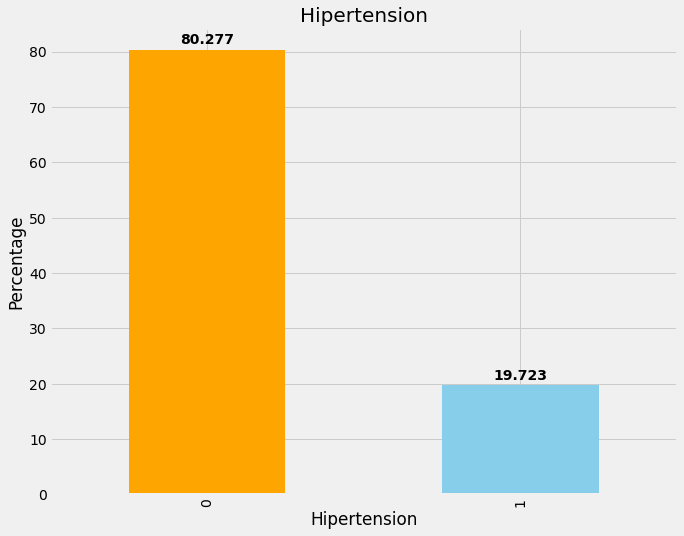

In [18]:
plot_value_counts(df, 'Hipertension')

There are 20% of the people who have Hypertension, while 80% are normal.

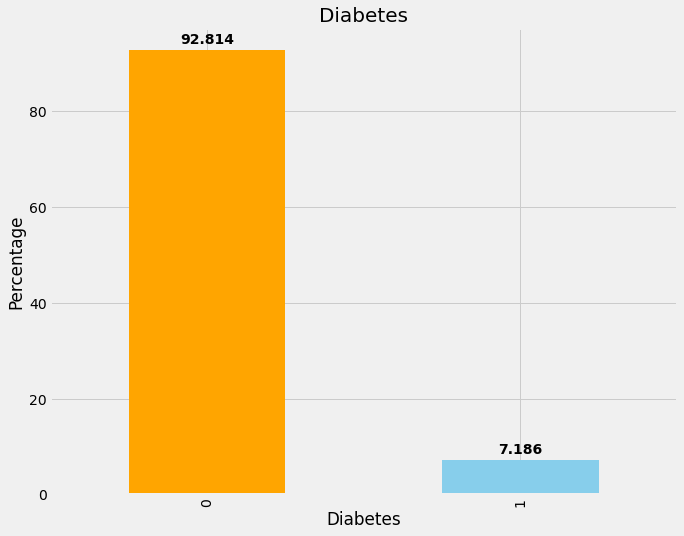

In [19]:
plot_value_counts(df, 'Diabetes')

In the collected sample, 7% have diabities while the remaining 93% are normal.

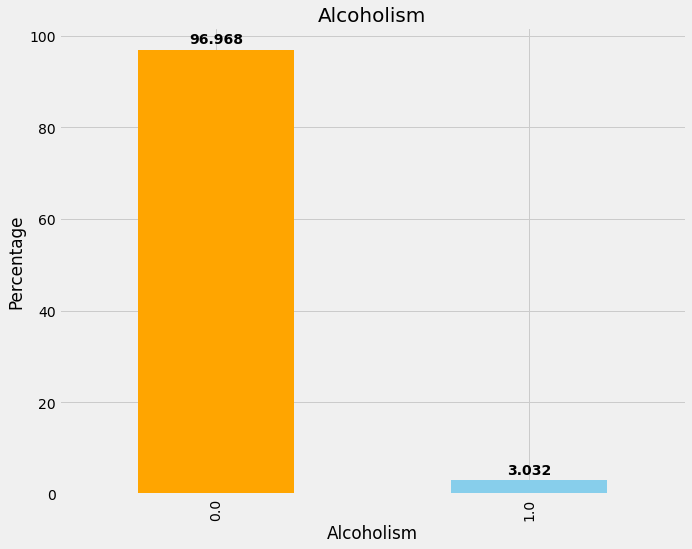

In [20]:
plot_value_counts(df, 'Alcoholism')

There are only 3% who consume alcohol, while the rest 97% are non-drinkers.

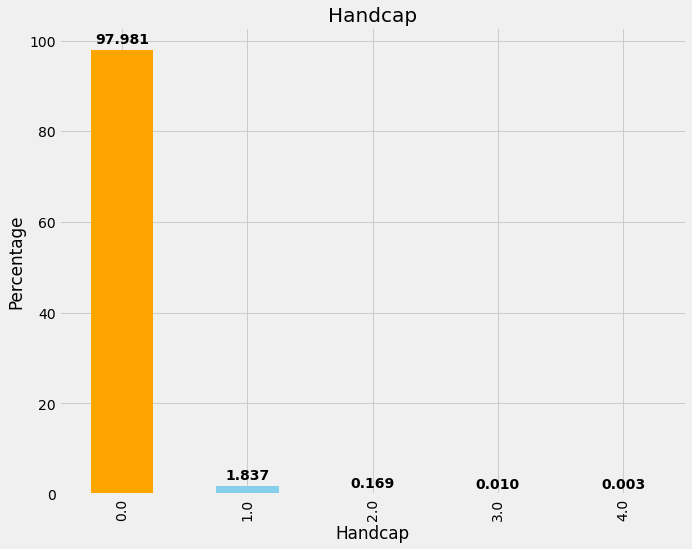

In [21]:
plot_value_counts(df, 'Handcap')

In [22]:
df['Handcap'] = df['Handcap'].replace([2,3,4], 1)

We See that handicap has values 0,1,2,3,4 where 0 means no handicap, 1 means handicap, while 2, 3, 4 are wrongly imputed values. Therefore we convert it to binary class variable by replacing 2,3,4 with 1, thereby converting it to a binary variable.

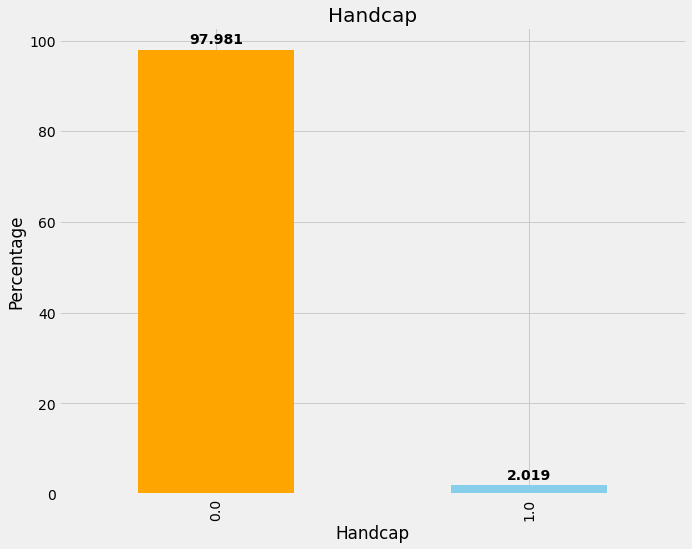

In [23]:
plot_value_counts(df, 'Handcap')

There are 2% of the people who are handicaped, while the rest 98% are normal.

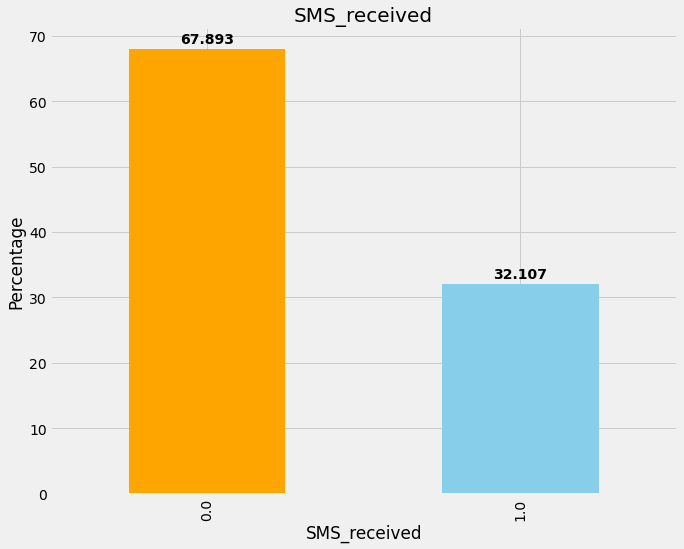

In [24]:
plot_value_counts(df, 'SMS_received')

Just 32% of the people have recceived the prior SMS notification about their booked appointments, remaining 68% haven't been notified.

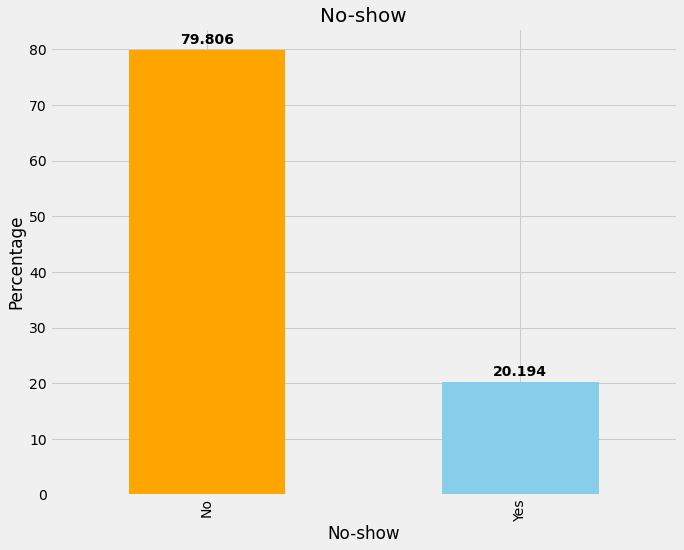

In [25]:
plot_value_counts(df, 'No-show')

In the collected data, 20% have missed their booked appointments, while the rest 80% have gone ahead with their scheduled appointment. Also, as we can see in the Target variable, there is a class imbalance. 

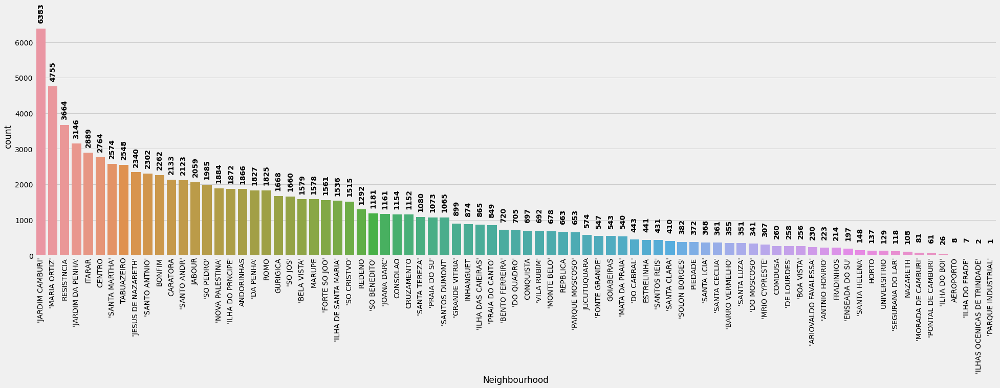

In [26]:
plt.rcParams['figure.figsize'] = (30,8)
p1 = sns.countplot(df['Neighbourhood'], order = df['Neighbourhood'].value_counts().index)
for p in p1.patches:
  p1.annotate(f'{p.get_height():0.0f}', (p.get_x() + p.get_width() / 2., p.get_height()), ha = 'center', va = 'center', 
                      xytext = (0, 30), textcoords = 'offset points', weight = 'bold', rotation = 90)
plt.xticks(rotation = 90)
plt.show()

In the above countplot we see that there are lot of neighbourhoods with the most number of patients coming from Jardim Camburi followed by Maria critz and so on. For better analysis we need to bucketize them into fewer groups.

In [27]:
import plotly.express as px

fig = px.histogram(df, x="Age")
fig.show()

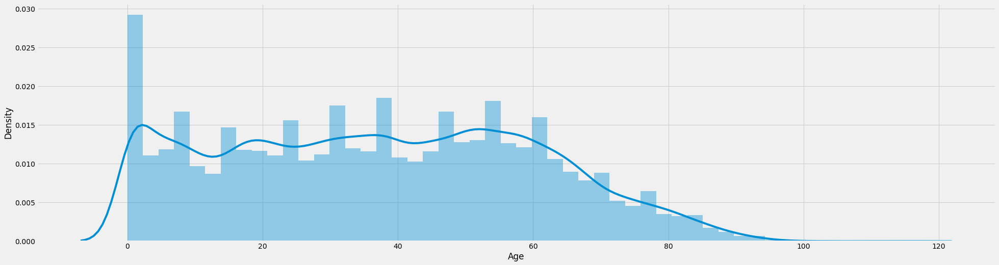

In [28]:
sns.distplot(df['Age'])
plt.show()

In [29]:
df['Age'].skew()

0.12302378334887859

We see that age is positively skewed with high chance of outliers being present in the data.

In [30]:
fig = px.box(df, y = 'Age')
fig.show()

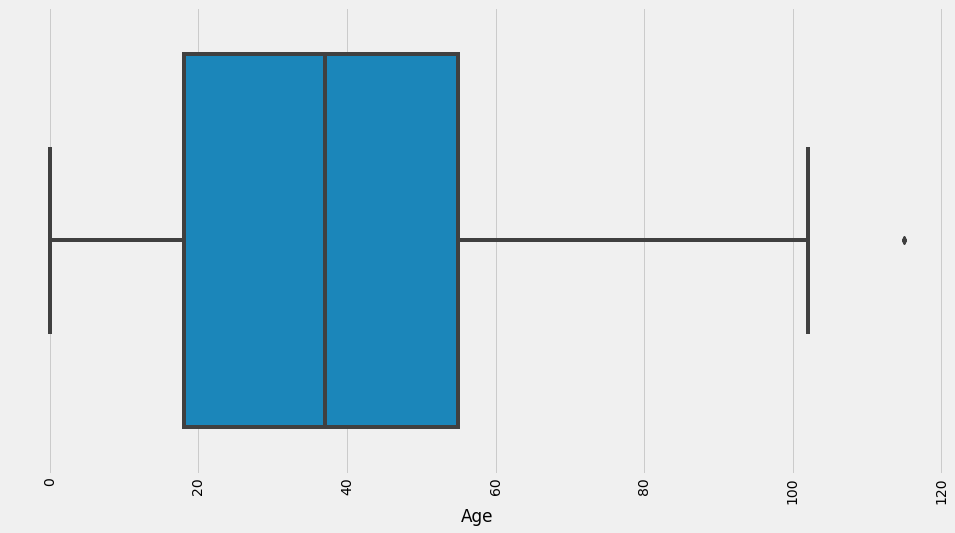

In [31]:
plt.figure(figsize=(15,8))
plt.xticks(rotation=90)
sns.boxplot(df.Age)
plt.show()

We see that for age outliers indeed exists.

# Bivariate Analysis

In [32]:
sms_noshow = pd.crosstab(index = df['No-show'], columns = df['SMS_received'], normalize = 'all')*100
sms_noshow

SMS_received,0.000000,1.000000
No-show,,
No,56.531659,23.232951
Yes,11.361423,8.873967


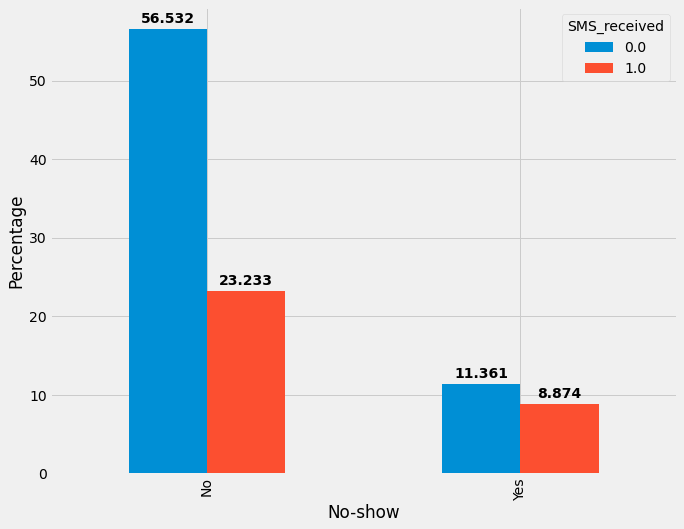

In [33]:
plt.rcParams['figure.figsize'] = (10, 8)
p1 = (pd.crosstab(index = df['No-show'], columns = df['SMS_received'], normalize = 'all')*100).plot.bar(stacked = False)
for p in p1.patches:
  p1.annotate(f'{p.get_height():0.3f}', (p.get_x() + p.get_width() / 2., p.get_height()), ha = 'center', va = 'center', 
                      xytext = (0, 10), textcoords = 'offset points', weight = 'bold')
plt.ylabel('Percentage')
plt.show()

From the above metrics and plot we see that out of 80% of the total patients who came for appointment, 56.53% of patients did not receive any prior sms and 23.23% received prior sms. On the other hand out of the total 20% of the patients who did not show up for their appointments 11.36% did not receive any prior sms and 8.87% did receive prior sms.

In [34]:
Handicap_noshow = pd.crosstab(index = df['No-show'], columns = df['Handcap'], normalize = 'all')*100
Handicap_noshow

Handcap,0.000000,1.000000
No-show,,
No,78.154790,1.650649
Yes,19.826340,0.368222


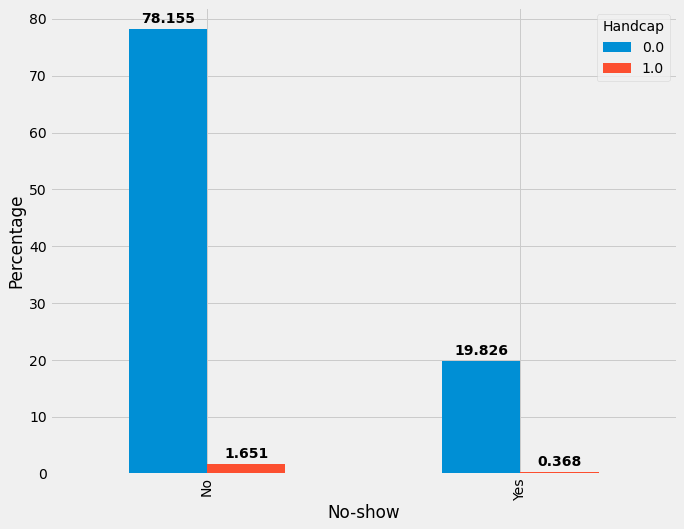

In [35]:
plt.rcParams['figure.figsize'] = (10, 8)
p1 = (pd.crosstab(index = df['No-show'], columns = df['Handcap'], normalize = 'all')*100).plot.bar(stacked = False)
for p in p1.patches:
  p1.annotate(f'{p.get_height():0.3f}', (p.get_x() + p.get_width() / 2., p.get_height()), ha = 'center', va = 'center', 
                      xytext = (0, 10), textcoords = 'offset points', weight = 'bold')
plt.ylabel('Percentage')
plt.show()

From the above metrics and plot we see that out of 80% of the total patients who came for appointment, 78.15% of patients does not have any disability whereas 1.65% of the patients have some kind of diability. On the other hand out of the total 20% of the patients who did not show up for their appointments 19.82% of patients does not have any disability whereas 0.37% of the patients have some kind of diability.

In [36]:
alco_noshow = pd.crosstab(index = df['No-show'], columns = df['Alcoholism'], normalize = 'all')*100
alco_noshow

Alcoholism,0.000000,1.000000
No-show,,
No,77.417410,2.423730
Yes,19.550254,0.608606


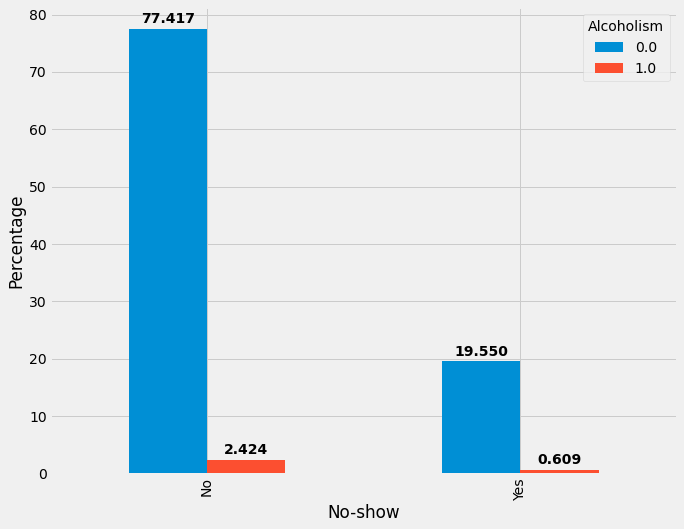

In [37]:
plt.rcParams['figure.figsize'] = (10, 8)
p1 = (pd.crosstab(index = df['No-show'], columns = df['Alcoholism'], normalize = 'all')*100).plot.bar(stacked = False)
for p in p1.patches:
  p1.annotate(f'{p.get_height():0.3f}', (p.get_x() + p.get_width() / 2., p.get_height()), ha = 'center', va = 'center', 
                      xytext = (0, 10), textcoords = 'offset points', weight = 'bold')
plt.ylabel('Percentage')
plt.show()

From the above metrics and plot we see that out of 80% of the total patients who came for appointment, 77.42% of patients does not consume alcohol whereas 2.42% of the patients consumes alcohol. On the other hand out of the tolal 20% of the patients who did not show up for their appointments 19.55% of patients does not consume alcohol whereas 0.61% of the patients consumes alcohol.

In [38]:
diab_noshow = pd.crosstab(index = df['No-show'], columns = df['Diabetes'], normalize='all')*100
diab_noshow

Diabetes,0,1
No-show,,
No,73.914263,5.891933
Yes,18.899967,1.293837


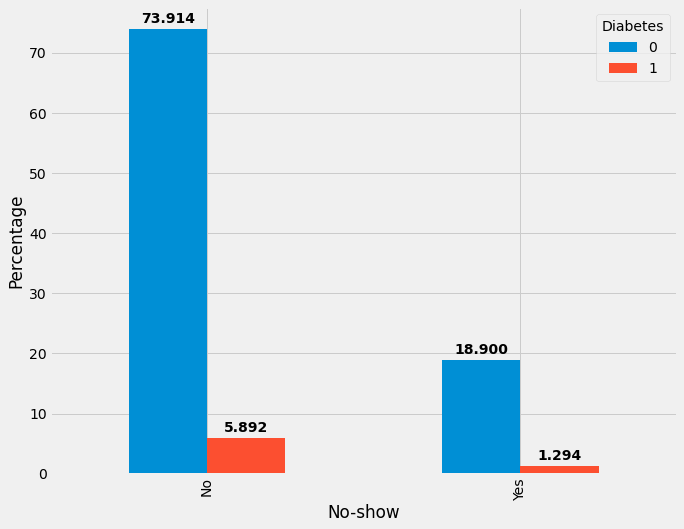

In [39]:
plt.rcParams['figure.figsize'] = (10, 8)
p1 = (pd.crosstab(index = df['No-show'], columns = df['Diabetes'], normalize='all')*100).plot.bar(stacked = False)
for p in p1.patches:
  p1.annotate(f'{p.get_height():0.3f}', (p.get_x() + p.get_width() / 2., p.get_height()), ha = 'center', va = 'center', 
                      xytext = (0, 10), textcoords = 'offset points', weight = 'bold')
plt.ylabel('Percentage')
plt.show()

From the above metrics and plot we see that out of 80% of the total patients who came for appointment, 73.91% of patients does not suffer from diabetes whereas 5.89% of the patients suffers from diabetes. On the other hand out of the tolal 20% of the patients who did not show up for their appointments 18.89% of patients does not suffer from diabetes whereas 1.29% of the patients suffers from diabetes.

In [40]:
hyper_noshow = pd.crosstab(index = df['No-show'], columns = df['Hipertension'], normalize='all')*100
hyper_noshow

Hipertension,0,1
No-show,,
No,63.495711,16.310485
Yes,16.780971,3.412833


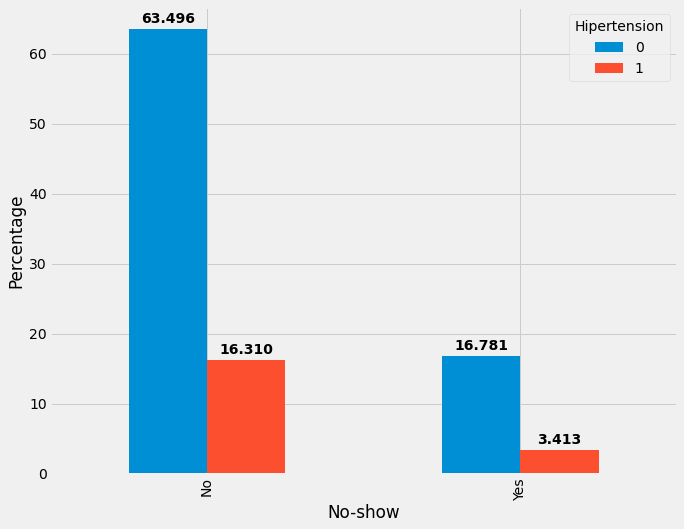

In [41]:
plt.rcParams['figure.figsize'] = (10, 8)
p1 = (pd.crosstab(index = df['No-show'], columns = df['Hipertension'], normalize='all')*100).plot.bar(stacked = False)
for p in p1.patches:
  p1.annotate(f'{p.get_height():0.3f}', (p.get_x() + p.get_width() / 2., p.get_height()), ha = 'center', va = 'center', 
                      xytext = (0, 10), textcoords = 'offset points', weight = 'bold')
plt.ylabel('Percentage')
plt.show()

From the above metrics and plot we see that out of 80% of the total patients who came for appointment, 63.49% of patients does not suffer from Hypertension whereas 16.31% of the patients suffers from Hypertension. On the other hand out of the tolal 20% of the patients who did not show up for their appointments 16.78% of patients does not suffer from Hypertension whereas 3.41% of the patients suffers from Hypertension.

In [42]:
scholar_noshow = pd.crosstab(index = df['No-show'], columns = df['Scholarship'], normalize='all')*100
scholar_noshow

Scholarship,0.000000,1.000000
No-show,,
No,72.375286,7.478104
Yes,17.814166,2.332445


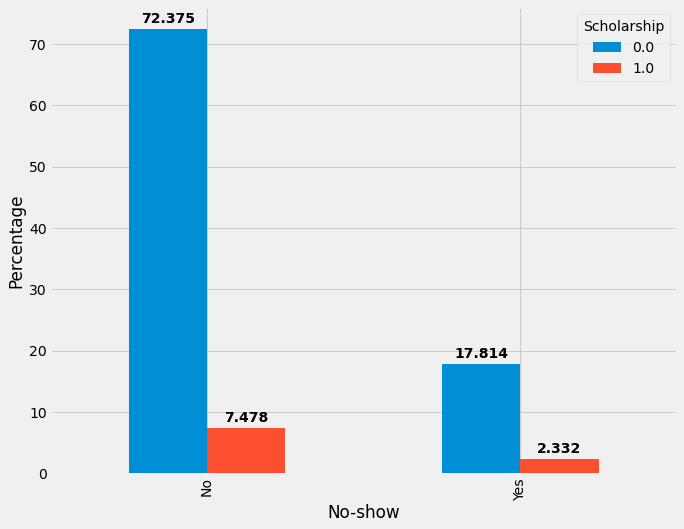

In [43]:
plt.rcParams['figure.figsize'] = (10, 8)
p1 = (pd.crosstab(index = df['No-show'], columns = df['Scholarship'], normalize='all')*100).plot.bar(stacked = False)
for p in p1.patches:
  p1.annotate(f'{p.get_height():0.3f}', (p.get_x() + p.get_width() / 2., p.get_height()), ha = 'center', va = 'center', 
                      xytext = (0, 10), textcoords = 'offset points', weight = 'bold')
plt.ylabel('Percentage')
plt.show()

From the above metrics and plot we see that out of 80% of the total patients who came for appointment, 72.37% of patients does not have scholarship whereas 7.48% of the patients have scholarship. On the other hand out of the tolal 20% of the patients who did not show up for their appointments 17.81% of patients does not have scholarship whereas 2.33% of the patients have scholarship.

In [44]:
df.groupby('No-show').mean()['Age']

No-show
No    37.774872
Yes   34.277212
Name: Age, dtype: float64

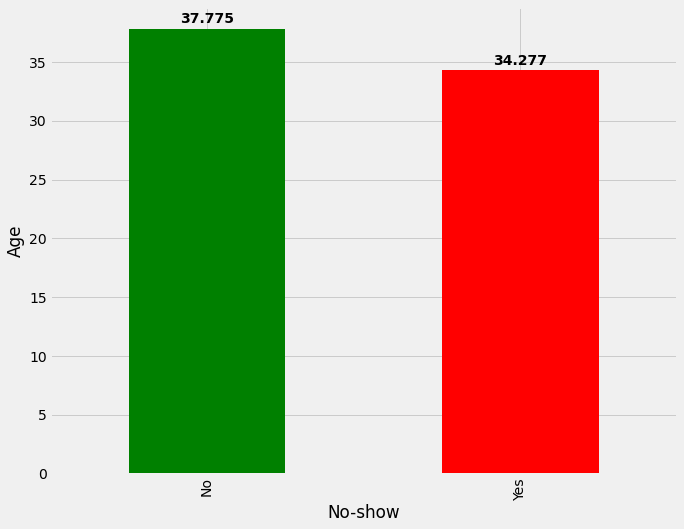

In [45]:
plt.rcParams['figure.figsize'] = (10,8)
p1 = df.groupby('No-show').mean()['Age'].plot(kind='bar', color=['green', 'red'])
for p in p1.patches:
  p1.annotate(f'{p.get_height():0.3f}', (p.get_x() + p.get_width() / 2., p.get_height()), ha = 'center', va = 'center', 
                      xytext = (0, 10), textcoords = 'offset points', weight = 'bold')
plt.ylabel("Age")
plt.show()

From the above metrics and plot we see that, for the patients who showed up for the appointment their average age is 37 years, whereas for the patients who did not show up for the apoinrments their average age is around 34 years.

In [46]:
gender_noshow = pd.crosstab(index = df['No-show'], columns = df['Gender'], normalize='all')*100
gender_noshow

Gender,F,M
No-show,,
No,51.754471,28.057032
Yes,13.217980,6.970517


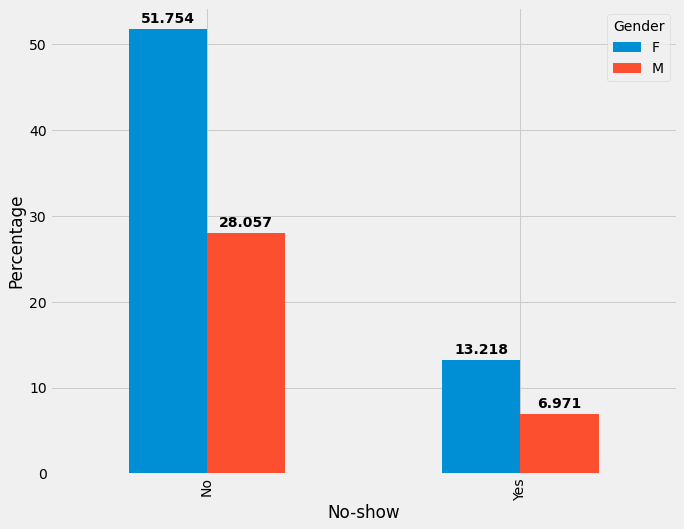

In [47]:
plt.rcParams['figure.figsize'] = (10, 8)
p1 = (pd.crosstab(index = df['No-show'], columns = df['Gender'], normalize='all')*100).plot.bar(stacked = False)
for p in p1.patches:
  p1.annotate(f'{p.get_height():0.3f}', (p.get_x() + p.get_width() / 2., p.get_height()), ha = 'center', va = 'center', 
                      xytext = (0, 10), textcoords = 'offset points', weight = 'bold')
plt.ylabel('Percentage')
plt.show()

From the above metrics and plot we see that out of 80% of the total patients who came for appointment, 53.54% of patients are female whereas 26.26% of the patients are male. On the other hand out of the tolal 20% of the patients who did not show up for their appointments 13.66% of patientsare female whereas 6.52% of the patients are male.

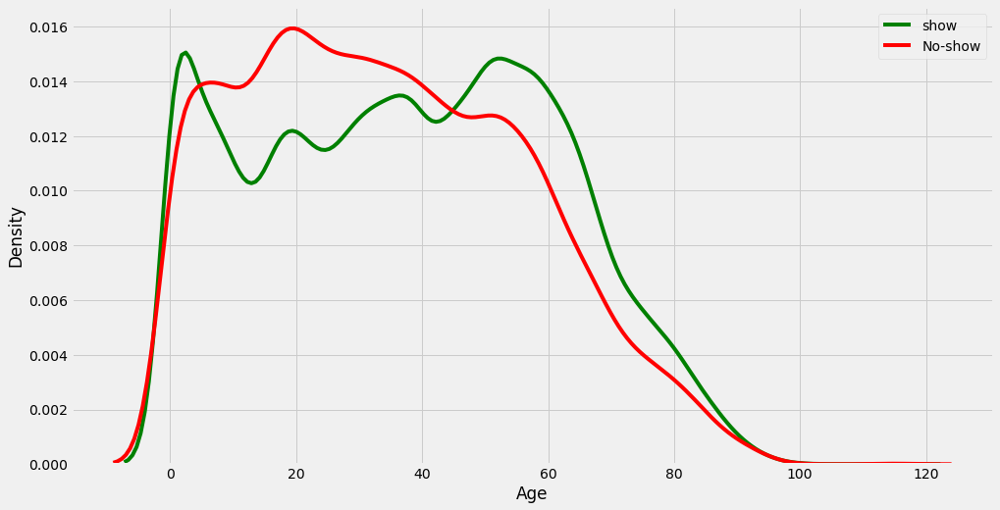

In [48]:
plt.rcParams['figure.figsize'] = (15,8)
sns.distplot(df[df['No-show'] == 'No']["Age"], color='green',label='show',hist=False)
sns.distplot(df[df['No-show'] == 'Yes']["Age"], color='red',label='No-show',hist=False)
plt.legend()
plt.show()

In [49]:
print(df[df['No-show'] == 'No']["Age"].skew())
print(df[df['No-show'] == 'Yes']["Age"].skew())

0.0702115081215269
0.33025901345606445


As we see in the kde plot, the distribution of Age is nearly normal for the people who have not missed their appointment schedule, while there is a bit of positive skewness comparitively in the Age among those who have missed the appointment schedule.

Overall Age has bit of a rightly skewed distribution.

In [50]:
# sns.boxplot(x = 'Gender', y = 'Age', data = df)
# plt.show()

In [51]:
fig = px.box(df, x = 'Gender', y = 'Age')
fig.show()

As the boxplot shows, there is a potential outlier in Female group who Age is well over 100 years. For females, the average age is nearly 40 years and the distribution is slightly negative skewed. Male's age group covers the maximum age distribution around the mean while average being around 35 years, but the data is still negatively skewed.

In [52]:
fig = px.histogram(df, x="Age", nbins=20, title="Age Distribution", color='No-show', marginal="rug", 
                   hover_data=['Age'], opacity=0.5, template='plotly_dark')
fig.show()

In [53]:
fig = px.box(df, y = 'Age', color = 'No-show', hover_data = ['Age', 'No-show'])
fig.show()